# DriveLM Dataset 

## This notebook is for the analysis of the DriveLM dataset.

In [1]:
import json
import os
print(os.getcwd())
PROJECT_ROOT = os.path.abspath(os.path.join(os.getcwd(), "..", ".."))
os.chdir(PROJECT_ROOT)
print(os.getcwd())
from src.analysis.analyze_drive_lm import DriveLMAnalysis

/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG


### Preparation

What I tried to do was to have the training split of the DriveLM dataset, and tried to perform analysis of important items for both scene as well as key frame level, such as the distribution of question, and number of question types.
I tried to pick up a couple of interesting questions, and due to the interest of time, I was able to perform the RAG on these datapoints.

In [ ]:
drive_lm_train_file = "resources/data/drivelm/v1_1_train_nus.json"
with open(drive_lm_train_file, "r") as file:
    drive_lm_data = json.load(file)

drive_lm = DriveLMAnalysis(train_dict=drive_lm_data)
all_question_stat, per_scene_question_stat = drive_lm.process_analysis()

perception = []
prediction = []
planning = []
behavior = []

for k, v in all_question_stat.items():
    if "perception" in v:
        perception.append(v["perception"])
    if "prediction" in v:
        prediction.append(v["prediction"])
    if "planning" in v:
        planning.append(v["planning"])
    if "behavior" in v:
        behavior.append(v["behavior"])

min, max = drive_lm.find_min_max_value([perception, prediction, planning, behavior])

min, max

### Distribution (Per Key Frame)

We we have next is a display of the distribution of the questions.
We see a nice Gaussian like distribution for the Perception type of questions, while we see just one column for the Behaviour type of questions.

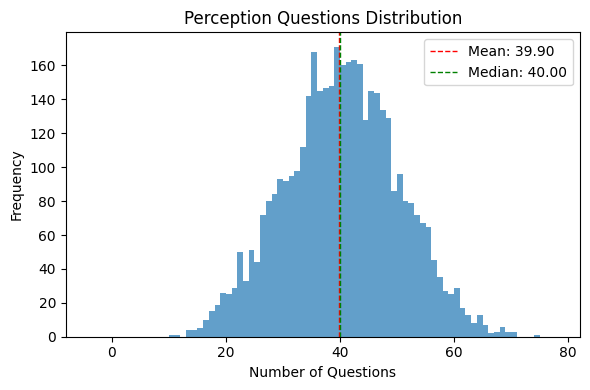

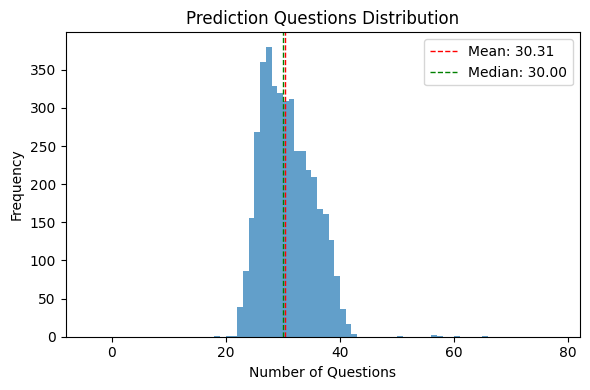

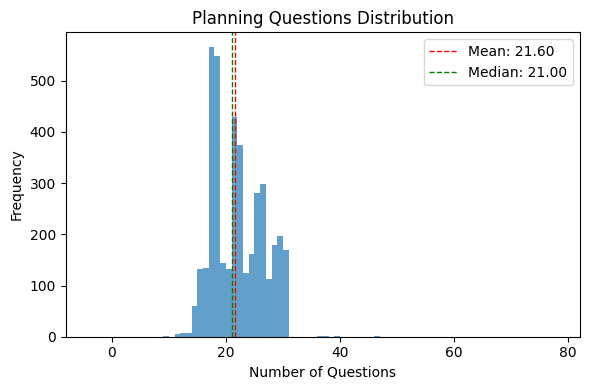

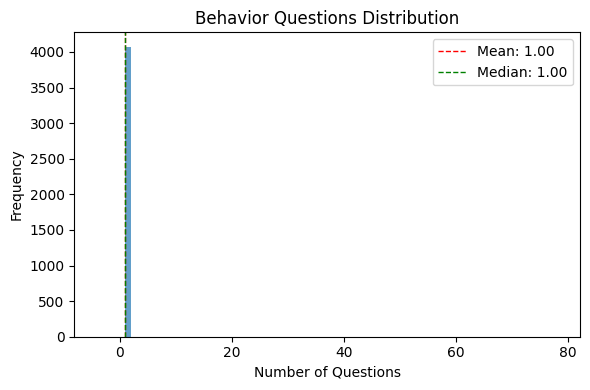

In [8]:
drive_lm.plot_list_distribution(values=perception, title="Perception Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=prediction, title="Prediction Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=planning, title="Planning Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=behavior, title="Behavior Questions Distribution", min_=min, max_=max)

### Comnparative Analysis of the Question Types (Per Key Frame)

What we see here is that most of the questions we have are present as perception questions - which is an interesting philosophical observation - we are still at the the stage where we aren't sure if our solutions are able to conpletely comprehend everything in their surroundings.


We have the lease number of behaviour questions, which might show that what the vehicle needs to do is secondary, when we are not able to completely understand what is going on in the scene.

/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:271: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:276: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:281: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(names, rotation=45, ha="right")


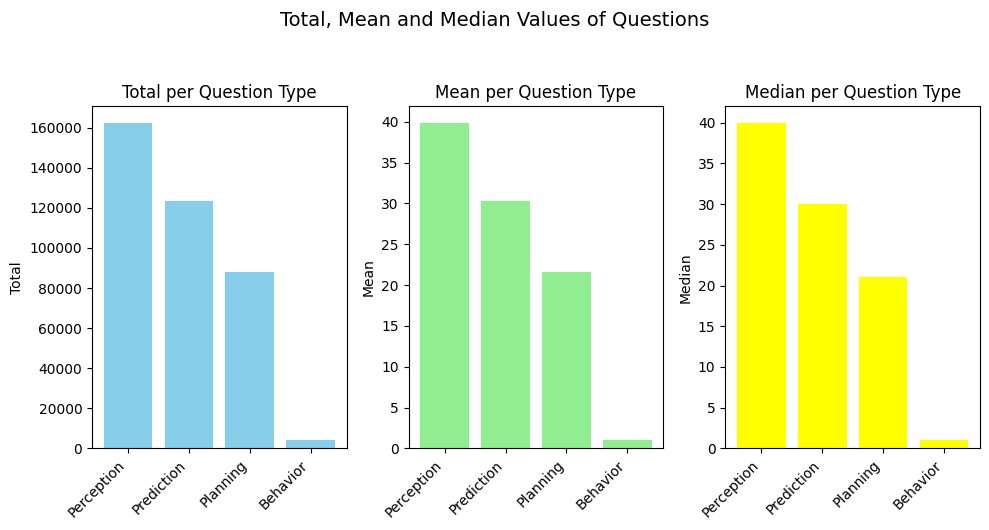

In [9]:
drive_lm.plot_total(heading="Total, Mean and Median Values of Questions", lists_dict={
    "Perception": perception,
    "Prediction": prediction,
    "Planning": planning,
    "Behavior": behavior,
})

In [10]:
per_scene_perception = []
per_scene_prediction = []
per_scene_planning = []
per_scene_behavior = []

In [11]:
for k, v in per_scene_question_stat.items():
    if "perception" in v:
        per_scene_perception.append(v["perception"])
    if "prediction" in v:
        per_scene_prediction.append(v["prediction"])
    if "planning" in v:
        per_scene_planning.append(v["planning"])
    if "behavior" in v:
        per_scene_behavior.append(v["behavior"])

In [12]:
min, max = drive_lm.find_min_max_value([per_scene_perception, per_scene_prediction, per_scene_planning, per_scene_behavior])

min, max

(4, 520)

### Distribution (Per Scene)

We we have next is a display of the distribution of the questions per scene.
We see an almost Gaussian like distribution for the Perception type of questions, while we see just a thin distribution for the Behaviour type questions.

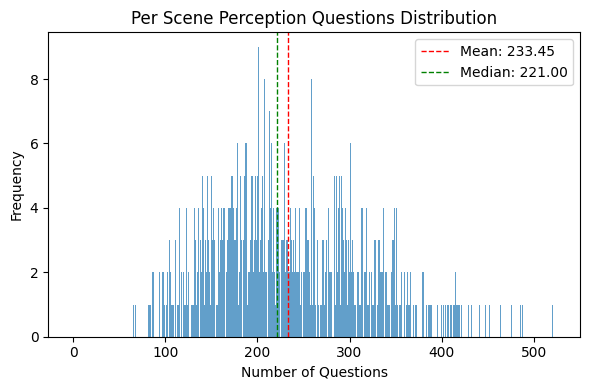

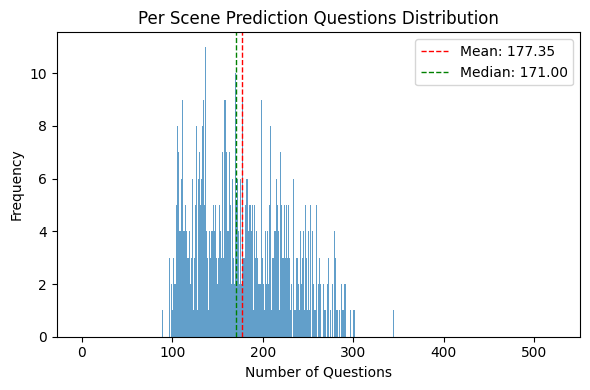

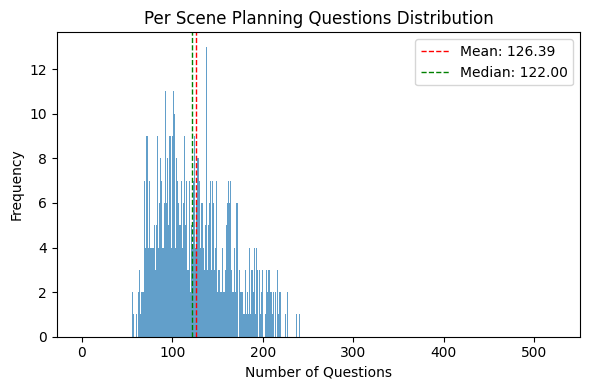

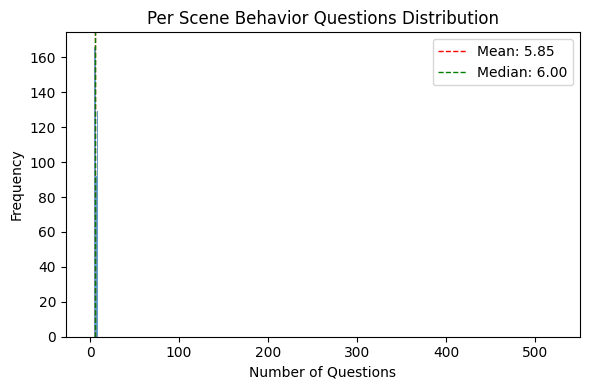

In [13]:
drive_lm.plot_list_distribution(values=per_scene_perception, title="Per Scene Perception Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=per_scene_prediction, title="Per Scene Prediction Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=per_scene_planning, title="Per Scene Planning Questions Distribution", min_=min, max_=max)
drive_lm.plot_list_distribution(values=per_scene_behavior, title="Per Scene Behavior Questions Distribution", min_=min, max_=max)

### Comnparative Analysis of the Question Types (Per Scene)

What we see here is the same as what we saw when looking at the question distribution when looking at them at the per key frame granular level.


Perception questions make up by far the most questions asked, while behaviour questions come in last, trailing the second least by quite a margin.

/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:271: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:276: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(names, rotation=45, ha="right")
/Users/rohitupadhya/Desktop/bosch/code/driveLM-RAG/src/analysis/analyze_drive_lm.py:281: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(names, rotation=45, ha="right")


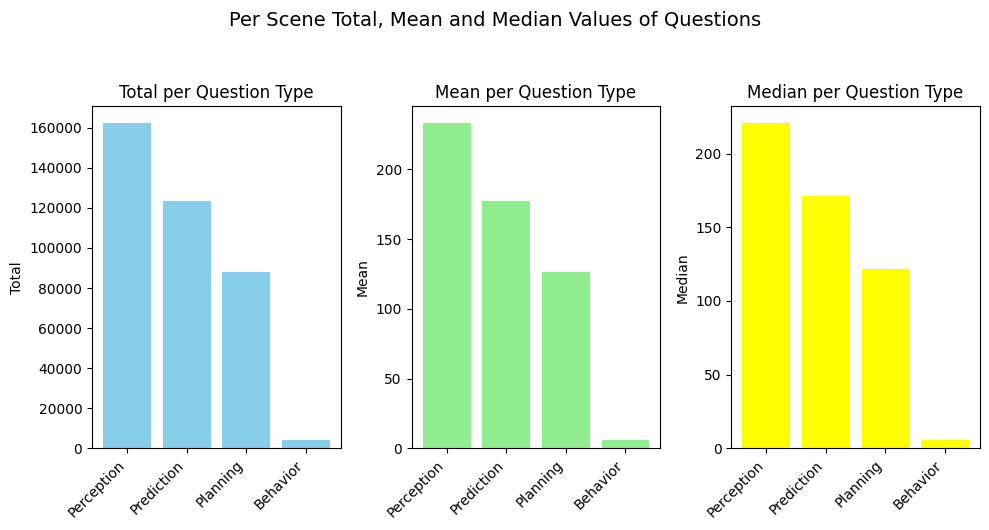

In [14]:
drive_lm.plot_total(heading="Per Scene Total, Mean and Median Values of Questions", lists_dict={
    "Perception": per_scene_perception,
    "Prediction": per_scene_prediction,
    "Planning": per_scene_planning,
    "Behavior": per_scene_behavior,
})

### Sample Images

Now we see some sample images that have been picked in random from the dataset. We also try to mark the important parts of the image using a red box using the bbox information given.

CAM_FRONT: 2 boxes


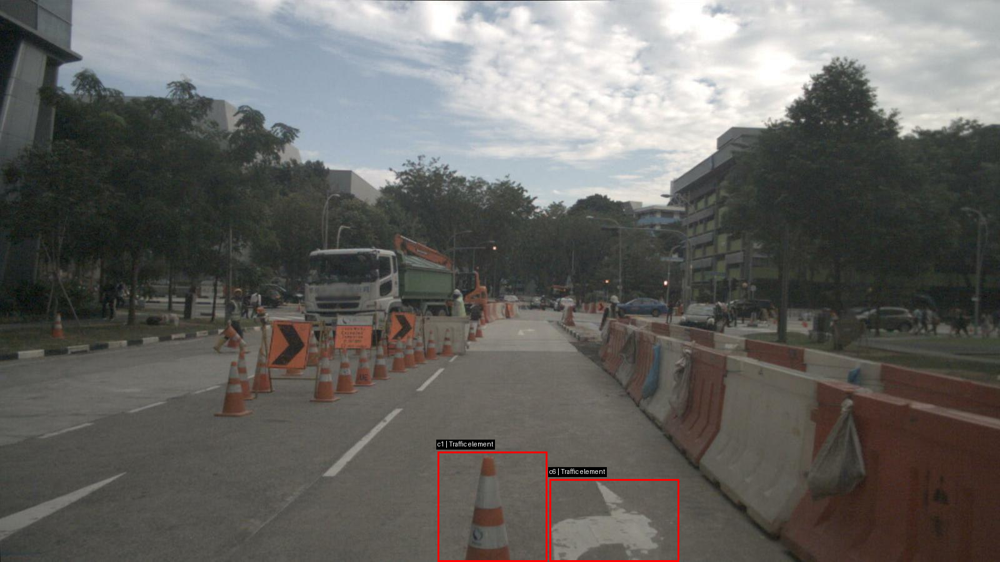

CAM_FRONT_LEFT: 1 boxes


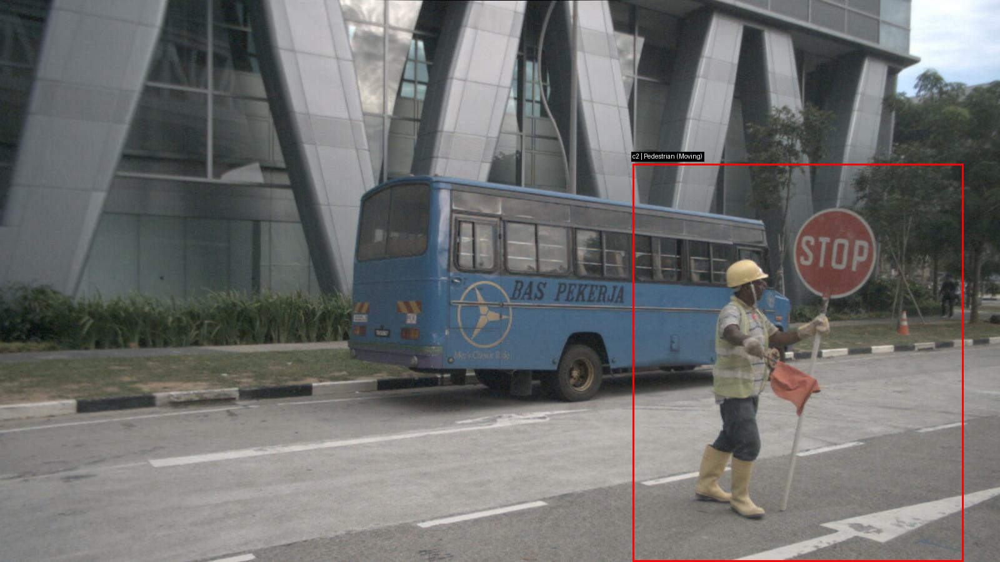

CAM_FRONT_RIGHT: 0 boxes


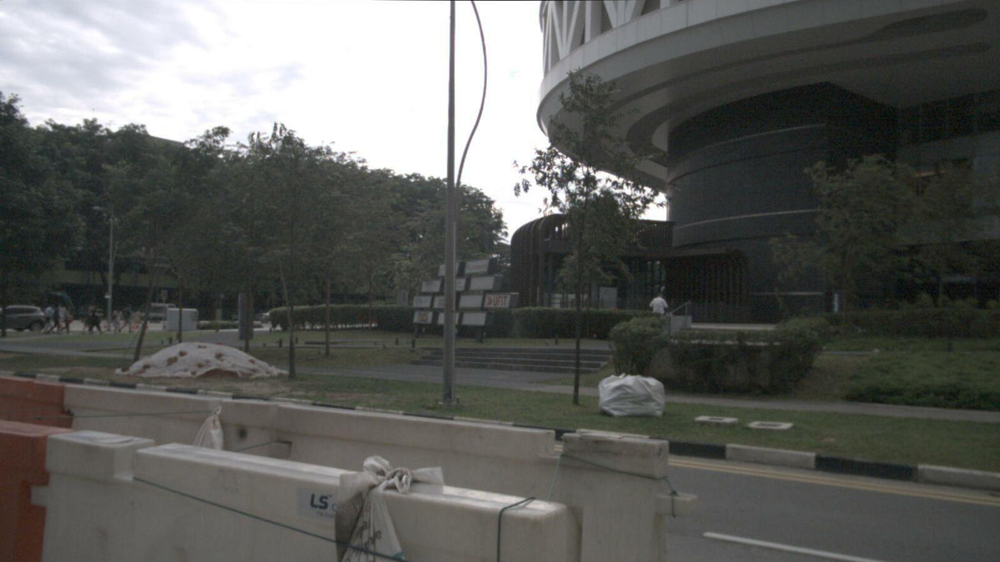

CAM_BACK: 1 boxes


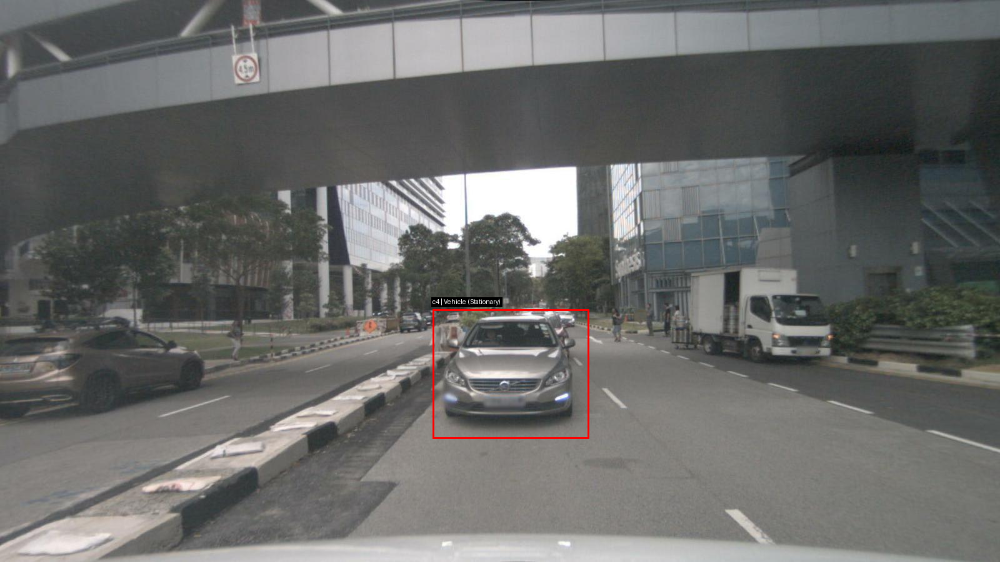

CAM_BACK_LEFT: 1 boxes


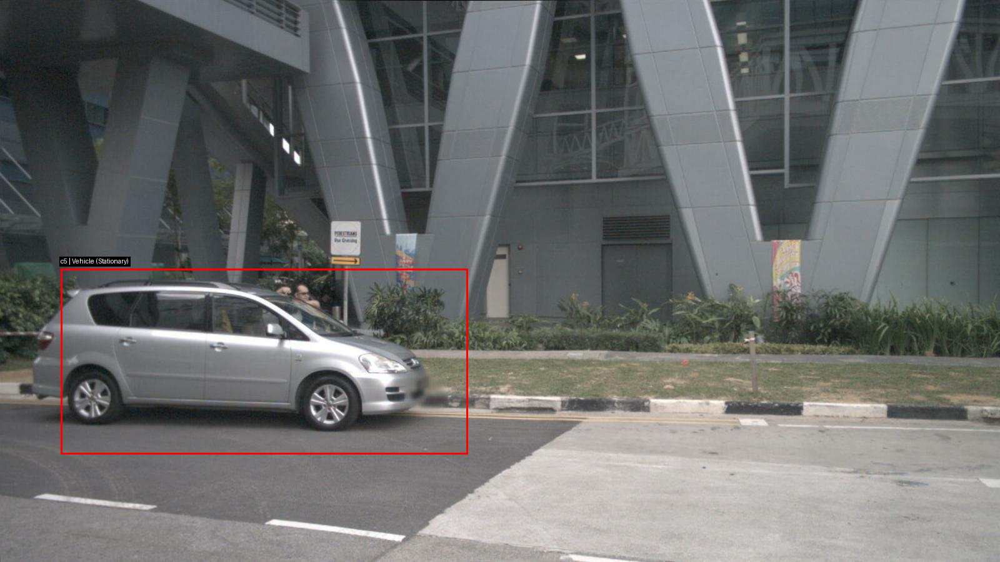

CAM_BACK_RIGHT: 1 boxes


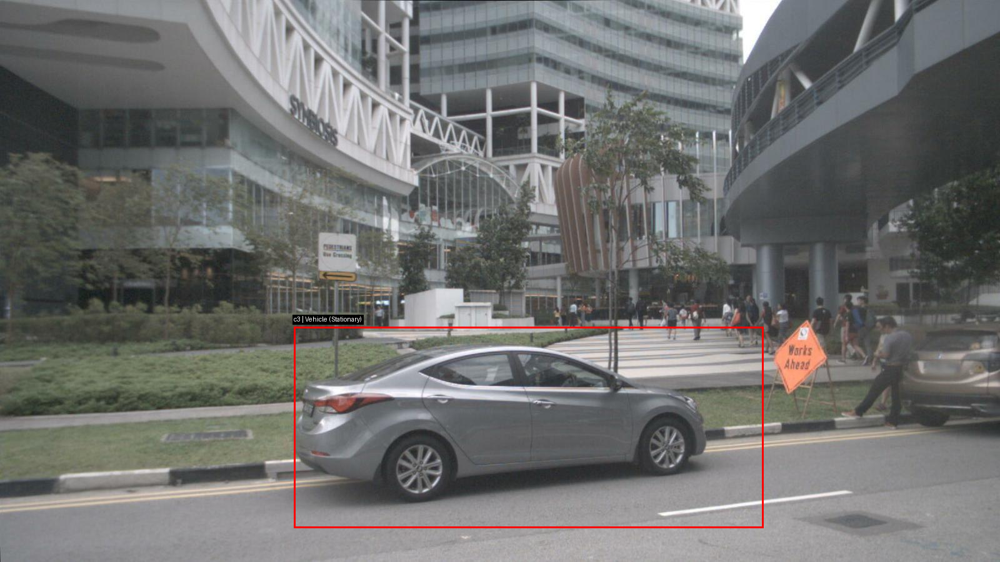

In [15]:
visualize_samples, _ = drive_lm.visualize_sample()

if visualize_samples:
    for cam, payload in visualize_samples.items():
        print(f"{cam}: {len(payload['boxes'])} boxes")
        display(payload["image"])

In [16]:
drive_lm_interesting_file = "resources/data/drivelm/interesting_set.json"
with open(drive_lm_interesting_file, "r") as file:
    interesting_drive_lm_data = json.load(file)

print(interesting_drive_lm_data)

{'f0f120e4d4b0441da90ec53b16ee169d': {'scene_description': 'The ego vehicle proceeds through the intersection, continuing along the current roadway.', 'key_frames': {'ffd1bdf020d145759224c629b501d2b2': {'key_object_infos': {'<c1,CAM_BACK,991.7,603.0>': {'Category': 'Vehicle', 'Status': 'Stationary', 'Visual_description': 'Champagne-colored sedan.', '2d_bbox': [769.2, 409.7, 1240.1, 796.3]}, '<c2,CAM_FRONT,836.3,398.3>': {'Category': 'Traffic element', 'Status': None, 'Visual_description': 'Green light.', '2d_bbox': [710.5, 303, 976.8, 493.6]}, '<c3,CAM_FRONT_LEFT,1075.5,382.8>': {'Category': 'Traffic element', 'Status': None, 'Visual_description': 'Red light.', '2d_bbox': [923.5, 257.2, 1245.2, 508.4]}}, 'QA': {'interesting': [{'Q': 'What object should the ego vehicle notice first when the ego vehicle is getting to the next possible location? What is the state of the object that is first noticed by the ego vehicle and what action should the ego vehicle take? What object should the ego 

In [17]:
interesting_drive_lm = DriveLMAnalysis(train_dict=interesting_drive_lm_data)

interesting_train_dict = interesting_drive_lm.train_dict

### Interesting Questions

Finally, I picked up some interesting questions from the dataset. I tried to show the question and the actual answer, as well as the images that correspond to this key frame.

CAM_FRONT: 1 boxes


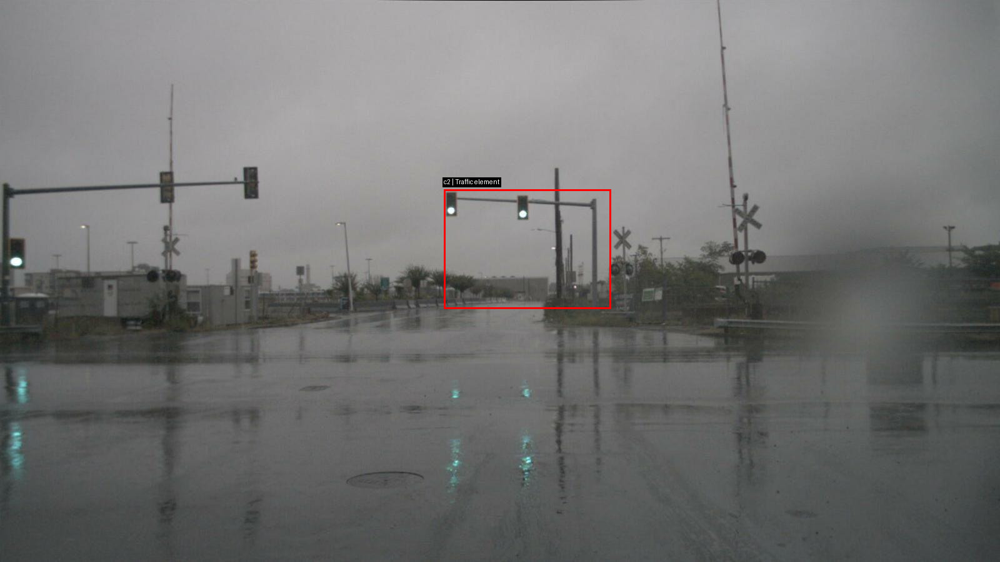

CAM_FRONT_LEFT: 1 boxes


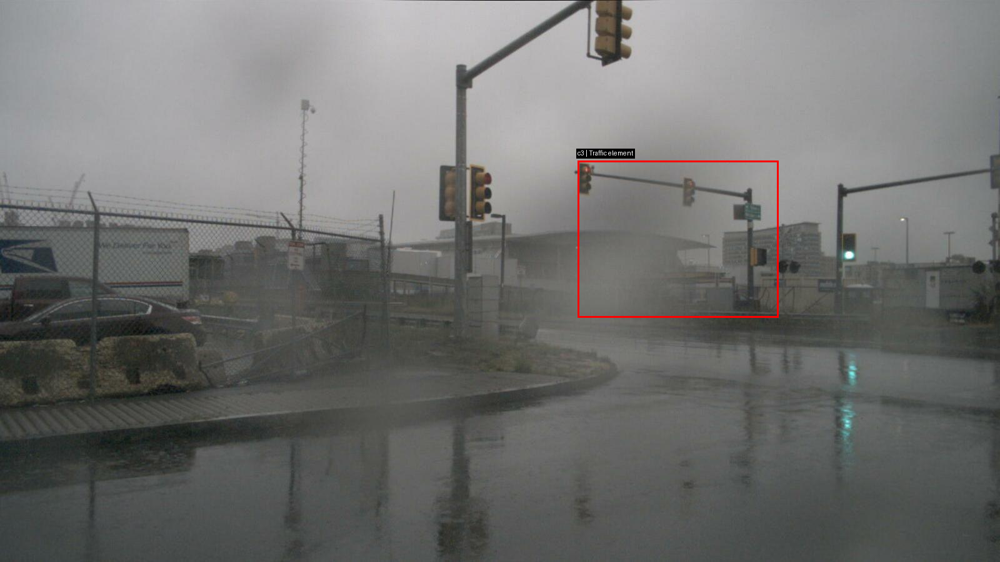

CAM_FRONT_RIGHT: 0 boxes


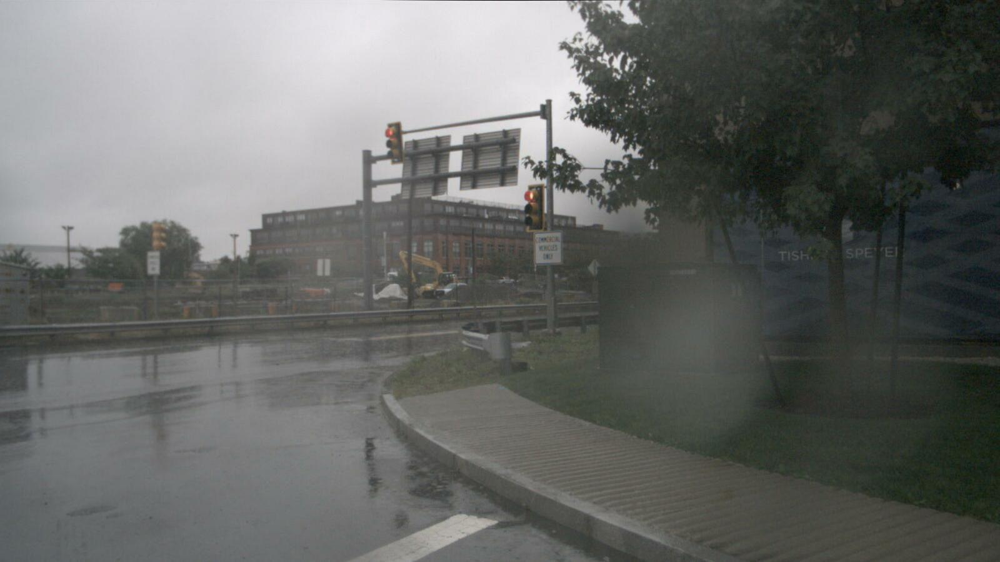

CAM_BACK: 1 boxes


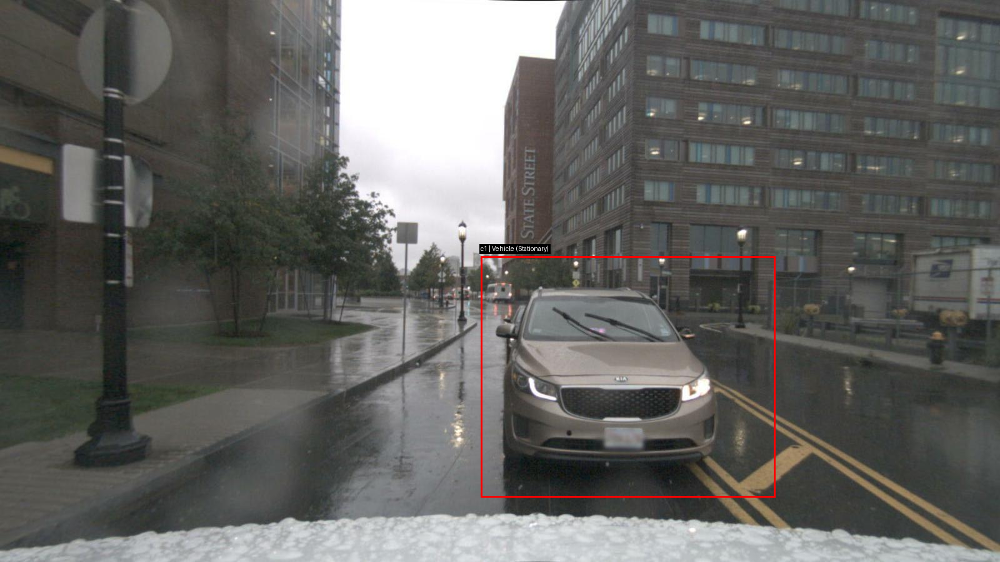

CAM_BACK_LEFT: 0 boxes


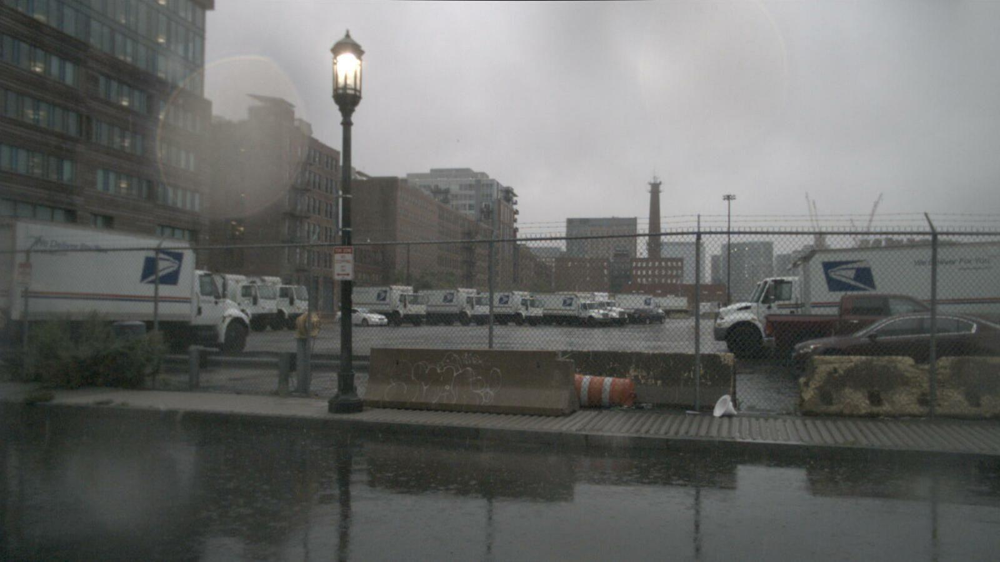

CAM_BACK_RIGHT: 0 boxes


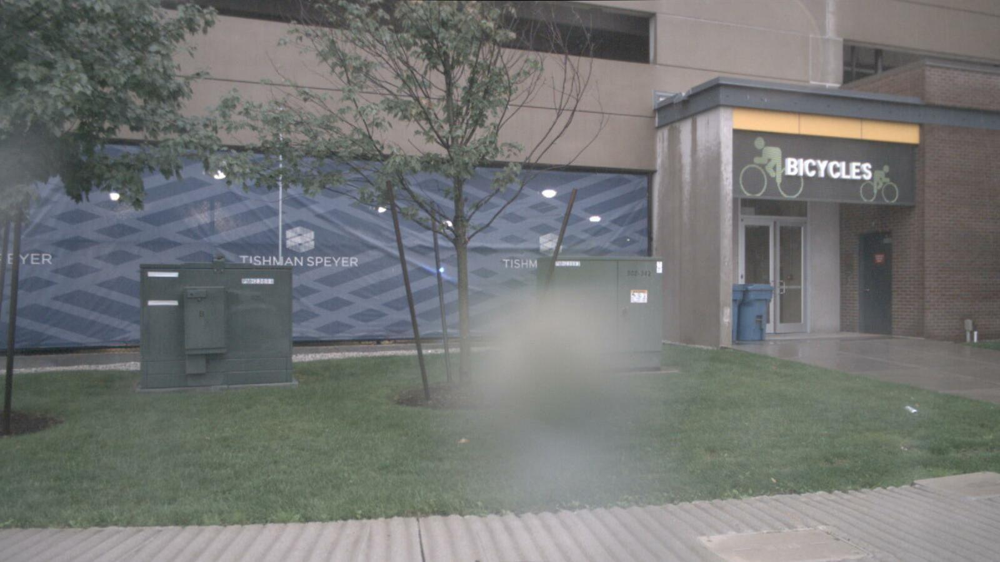

CAM_FRONT: 2 boxes


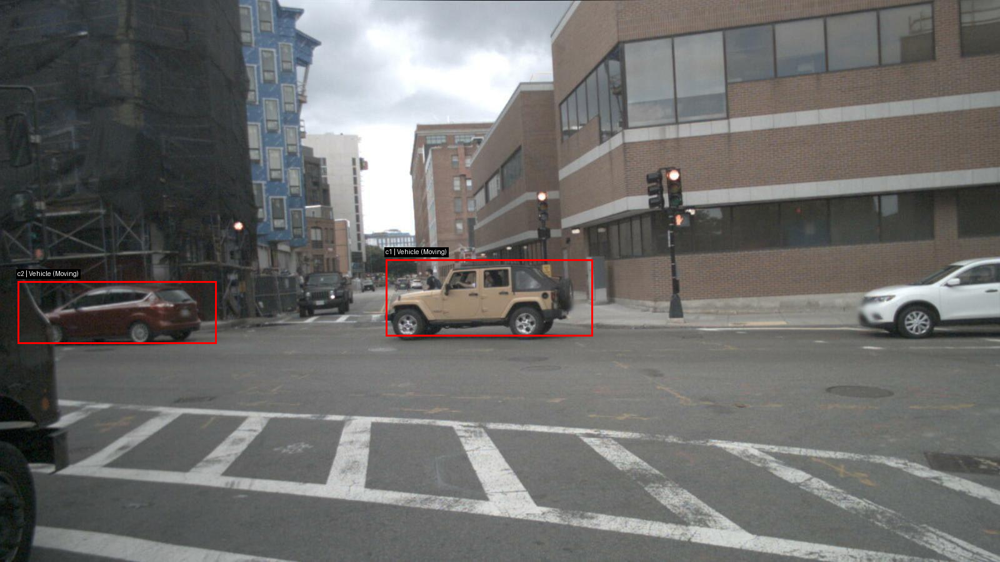

CAM_FRONT_LEFT: 1 boxes


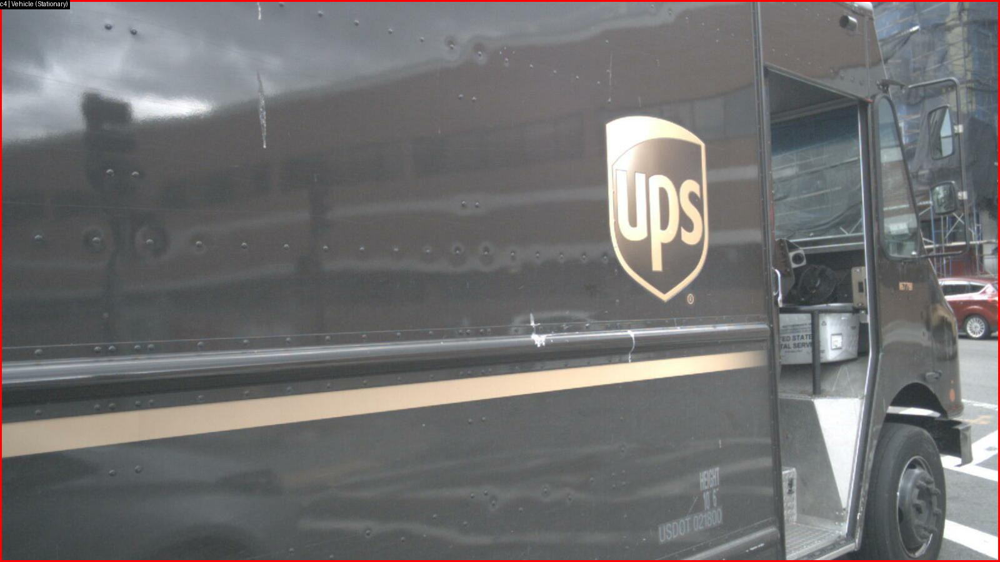

CAM_FRONT_RIGHT: 1 boxes


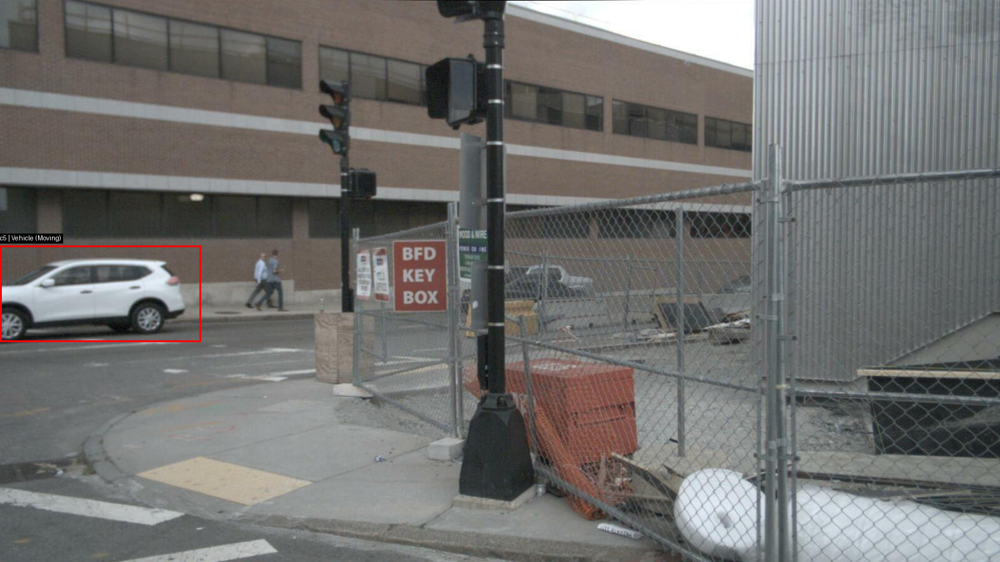

CAM_BACK: 1 boxes


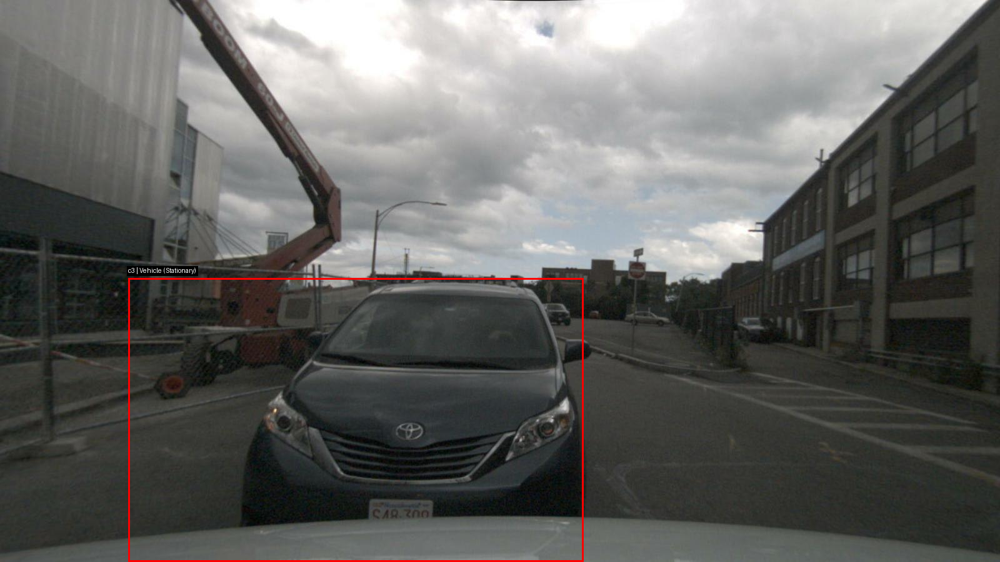

CAM_BACK_LEFT: 0 boxes


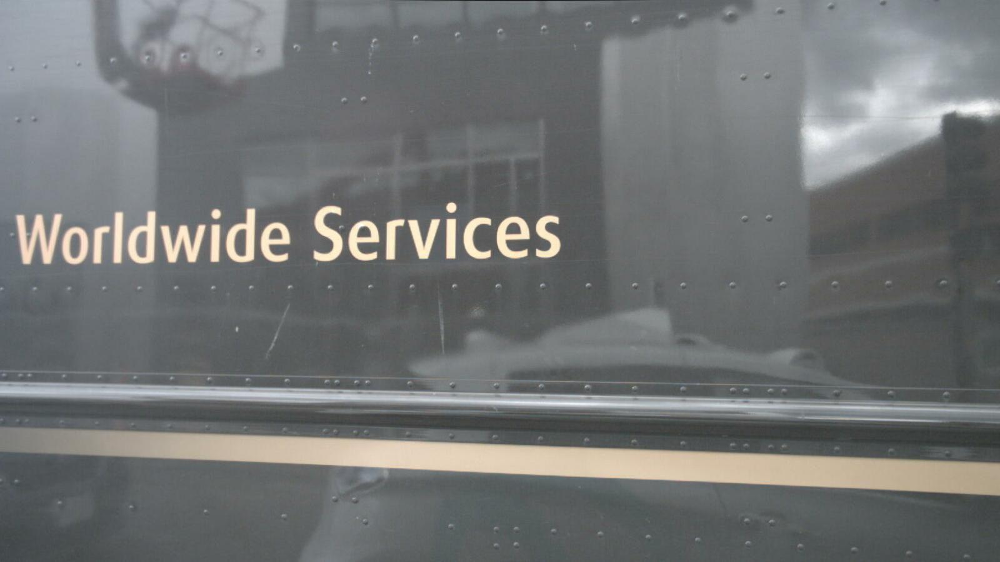

CAM_BACK_RIGHT: 0 boxes


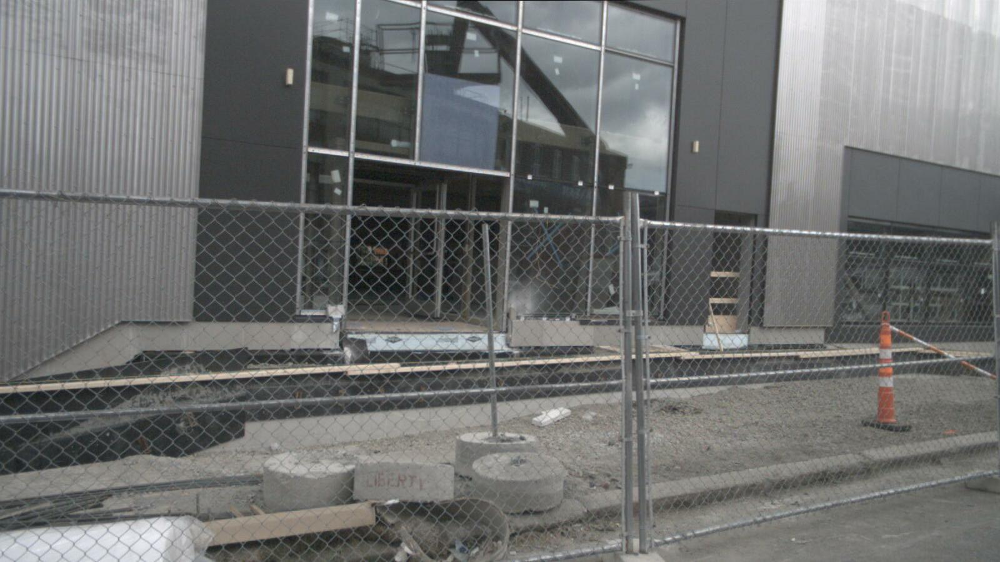

In [18]:
for item in interesting_train_dict:

    visualize_interesting_samples, questions = interesting_drive_lm.visualize_sample(scene_id=item)
    drive_lm.display_question_answer(questions["interesting"][0]["Q"], questions["interesting"][0]["A"])
    if visualize_interesting_samples:
        for cam, payload in visualize_interesting_samples.items():
            print(f"{cam}: {len(payload['boxes'])} boxes")
            display(payload["image"])
